In [1]:
import numpy as np
import matplotlib.pyplot as plt

import tensorflow as tf

from tensorflow.keras import Model, layers
from tensorflow.keras.applications import VGG16
from tensorflow.keras.optimizers import RMSprop
from tensorflow.keras.preprocessing import image
from tensorflow.keras.preprocessing.image import ImageDataGenerator

In [2]:
weights_file='C:/Users/SJH/JupyterNotebook/DeepLearning/vgg16_weights_tf_dim_ordering_tf_kernels_notop.h5'

vgg16 = VGG16(input_shape=(150, 150, 3), include_top=False, weights=None)

vgg16.load_weights(weights_file)

for layer in vgg16.layers:
     layer.trainable = False

vgg16.summary()

Model: "vgg16"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, 150, 150, 3)]     0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 150, 150, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 150, 150, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 75, 75, 64)        0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 75, 75, 128)       73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 75, 75, 128)       147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 37, 37, 128)       0     

In [3]:
last_layer = vgg16.get_layer('block5_pool')
last_output = last_layer.output

x = layers.Flatten()(last_output)
x = layers.Dense(1024, activation='relu')(x)
x = layers.Dropout(0.2)(x)
x = layers.Dense(512, activation='relu')(x)
x = layers.Dropout(0.2)(x)     
x = layers.Dense(256, activation='relu')(x)
x = layers.Dropout(0.2)(x)     
x = layers.Dense(10, activation='softmax')(x)           

model = Model(vgg16.input, x) 

model.compile(optimizer=RMSprop(lr=0.0001), loss='categorical_crossentropy', metrics=['accuracy'])

In [4]:
train_dir = 'C:/Users/SJH/JupyterNotebook/DeepLearning/img'
test_dir = 'C:/Users/SJH/JupyterNotebook/DeepLearning/img'

In [5]:
train_datagen = ImageDataGenerator(rescale = 1./255, validation_split=0.3)
train_generator = train_datagen.flow_from_directory(train_dir, target_size=(150,150), batch_size=20, class_mode='categorical', subset='training') 
validation_datagen = ImageDataGenerator(rescale = 1./255, validation_split=0.3)
validation_generator =  validation_datagen.flow_from_directory(test_dir, target_size=(150,150), batch_size=20, class_mode='categorical', subset='validation') 

Found 1554 images belonging to 10 classes.
Found 664 images belonging to 10 classes.


In [6]:
history = model.fit_generator(train_generator, validation_data=validation_generator, epochs=5, verbose=1)

Instructions for updating:
Please use Model.fit, which supports generators.
Epoch 1/5
78/78 [==============================] - 97s 1s/step - loss: 1.3722 - accuracy: 0.5566 - val_loss: 0.5981 - val_accuracy: 0.8479
Epoch 2/5
78/78 [==============================] - 98s 1s/step - loss: 0.6226 - accuracy: 0.8031 - val_loss: 0.3807 - val_accuracy: 0.8961
Epoch 3/5
78/78 [==============================] - 98s 1s/step - loss: 0.3855 - accuracy: 0.8771 - val_loss: 0.2336 - val_accuracy: 0.9292
Epoch 4/5
78/78 [==============================] - 100s 1s/step - loss: 0.2409 - accuracy: 0.9260 - val_loss: 0.2068 - val_accuracy: 0.9292
Epoch 5/5
78/78 [==============================] - 98s 1s/step - loss: 0.1607 - accuracy: 0.9517 - val_loss: 0.2319 - val_accuracy: 0.9187


In [7]:
scores = model.evaluate_generator(validation_generator, steps=20)
print("%s: %.2f%%" %(model.metrics_names[1], scores[1]*100))

Instructions for updating:
Please use Model.evaluate, which supports generators.
accuracy: 92.00%


In [8]:
# Visualizing CNN Layer Outputs
layer_cnt = 19 # VGG16 모델을 가져다가 쓰면 input_layer 1개 + Conv2D 13개 + MaxPooling 5개
layer_names = [layer.name for layer in model.layers[:layer_cnt]]
layer_outputs = [layer.output for layer in model.layers[:layer_cnt]]

activation_model = Model(inputs=model.input, outputs=layer_outputs)

# 예제 코드에서는 X_test[:1]로 간단하게 불러왔지만 여기서는 image.load_img로 불러옴
img = image.load_img('C:/Users/SJH/JupyterNotebook/DeepLearning/img/Cake/467.jpg')
input_arr = image.img_to_array(img) # 이미지 파일을 array 형식으로 변환
input_arr = np.array([input_arr]) # 3D Array를 4D Array로 변환
img_tensor = tf.image.resize(input_arr, [150, 150]) # 512x512 크기의 이미지를 150x150 크기로 변환

activations = activation_model.predict(img_tensor)

<ipython-input-9-9ff8f9ee7075>:34: UserWarning: Attempting to set identical bottom == top == -0.5 results in singular transformations; automatically expanding.
  plt.imshow(display_grid, aspect='auto', cmap='binary')
<ipython-input-9-9ff8f9ee7075>:21: RuntimeWarning: invalid value encountered in true_divide
  channel_image /= channel_image.std()


ValueError: 'box_aspect' and 'fig_aspect' must be positive

<Figure size 1152x0 with 2 Axes>

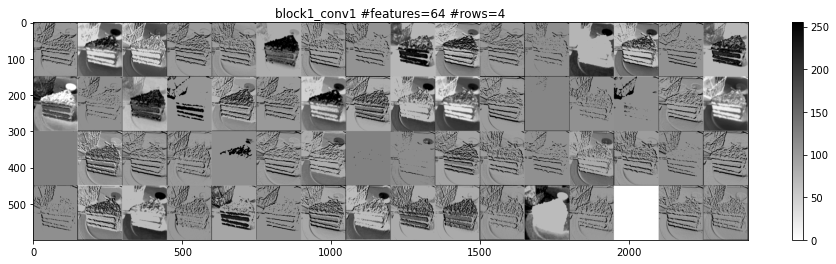

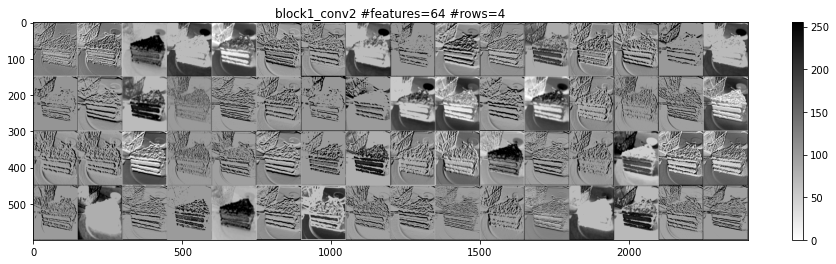

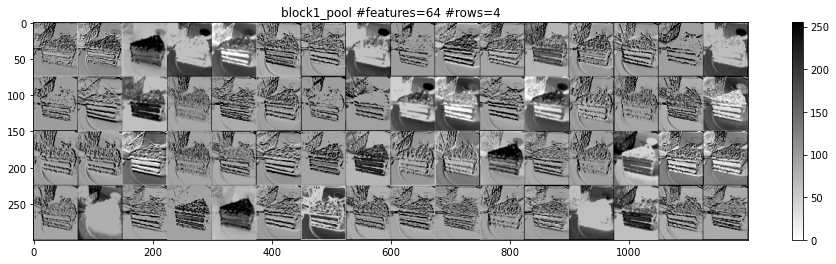

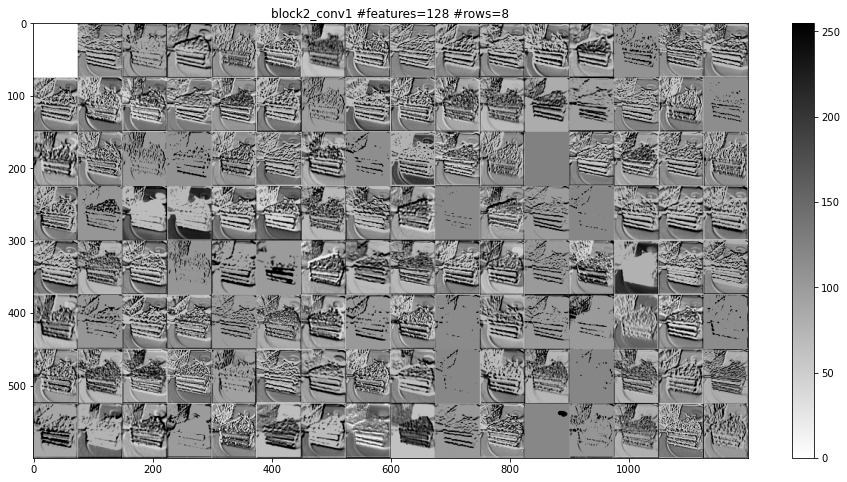

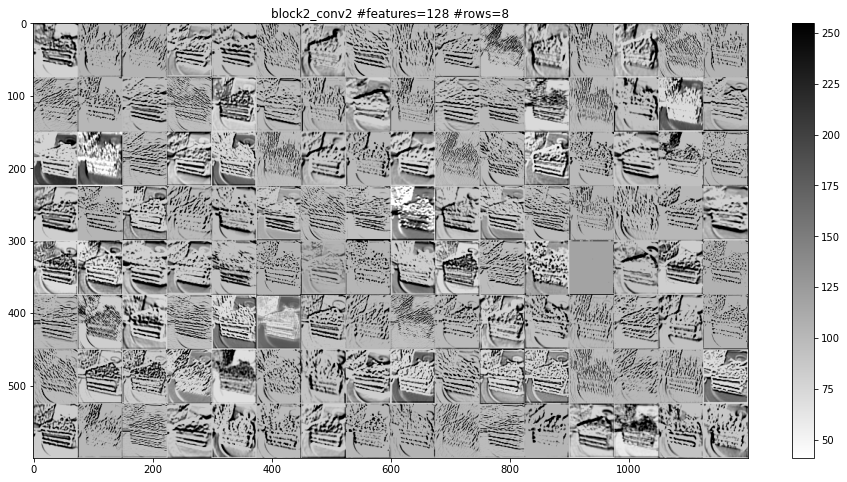

...

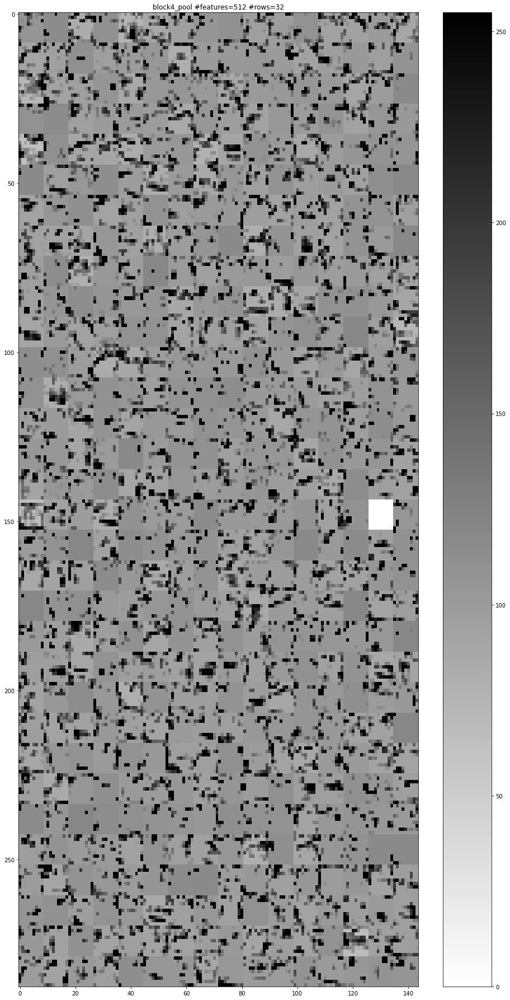

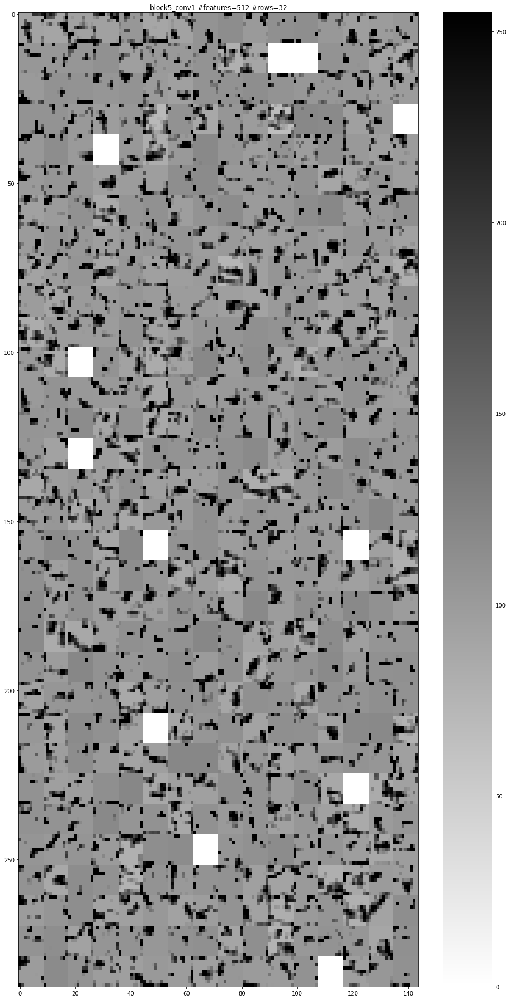

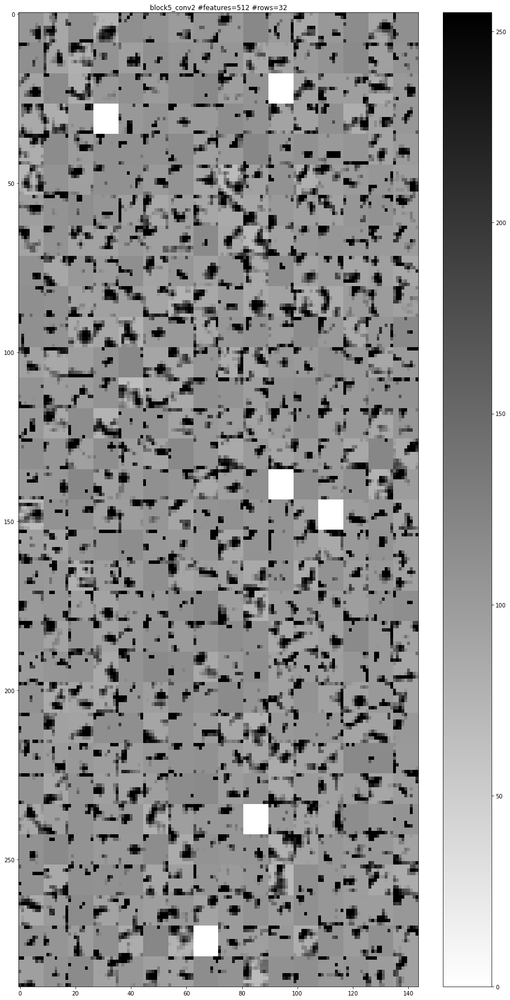

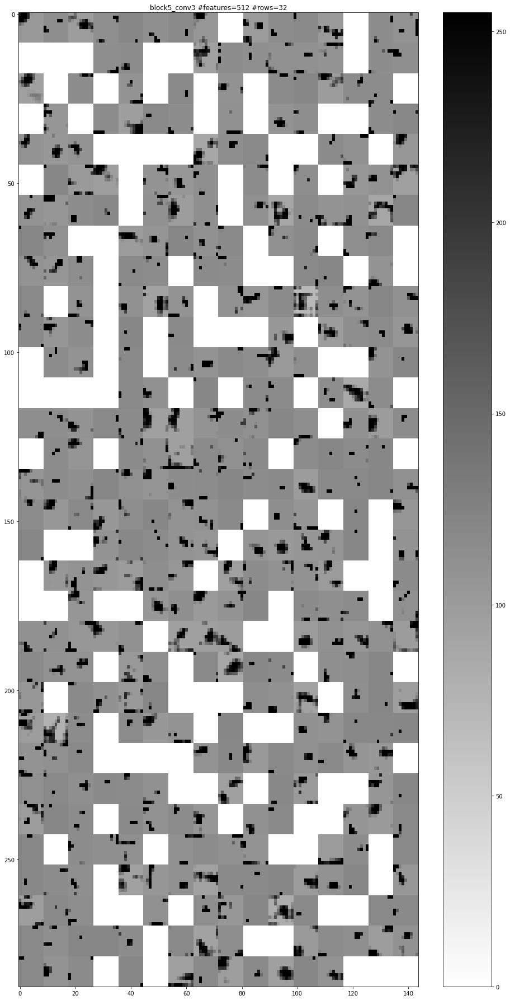

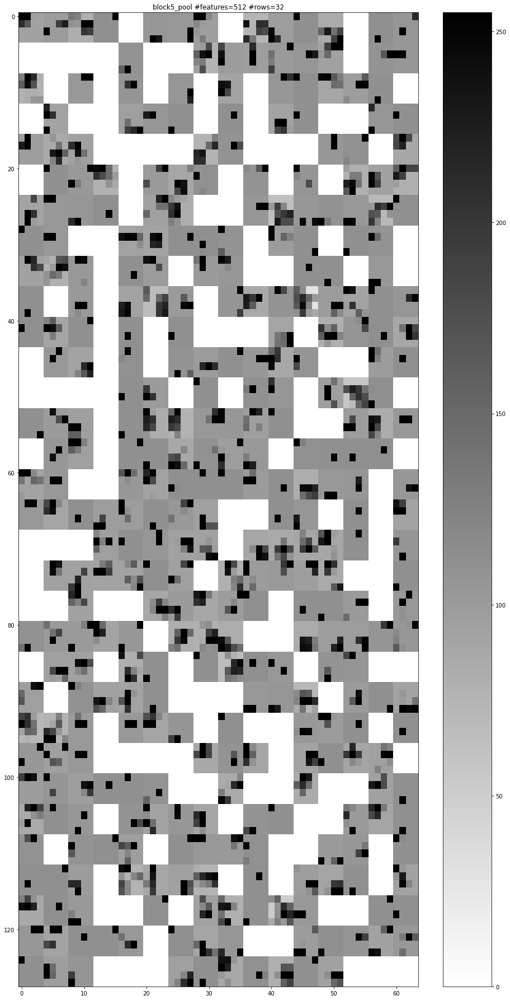

In [9]:
# Now let's display our feature maps
images_per_row = 16
for layer_name, layer_activation in zip(layer_names, activations):
    # This is the number of features in the feature map
    n_features = layer_activation.shape[-1]

    # The feature map has shape (1, size, size, n_features)
    size = layer_activation.shape[1]

    # We will tile the activation channels in this matrix
    n_cols = n_features // images_per_row
    # ksaehwa comments: n_cols should be n_rows for its real meaning
    display_grid = np.zeros((size * n_cols, images_per_row * size))

    # We'll tile each filter into this big horizontal grid
    for col in range(n_cols): # ksaehwa: n_cols is actuallly n_rows
        for row in range(images_per_row): # ksaehwa: row is actually col
            channel_image = layer_activation[0,:,:,col * images_per_row + row]
            # Post-process the feature to make it visually palatable
            channel_image -= channel_image.mean()
            channel_image /= channel_image.std()
            channel_image *= 64
            channel_image += 128
            channel_image = np.clip(channel_image, 0, 255).astype('uint8')
            display_grid[col * size : (col + 1) * size,
                         row * size : (row + 1) * size] = channel_image

    # Display the grid
    scale = 1. / size
    plt.figure(figsize=(scale * display_grid.shape[1], scale * display_grid.shape[0]))
    plt.title(layer_name + " #features=" + str(n_features) + " #rows=" +str(n_cols))
    plt.grid(False)
    #plt.imshow(display_grid, aspect='auto', cmap='viridis')
    plt.imshow(display_grid, aspect='auto', cmap='binary')
    plt.colorbar()

plt.show()

img_tensor.shape= (1, 150, 150, 3)


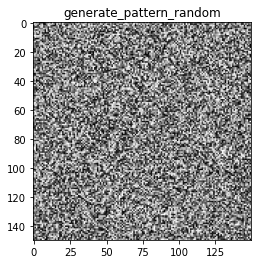

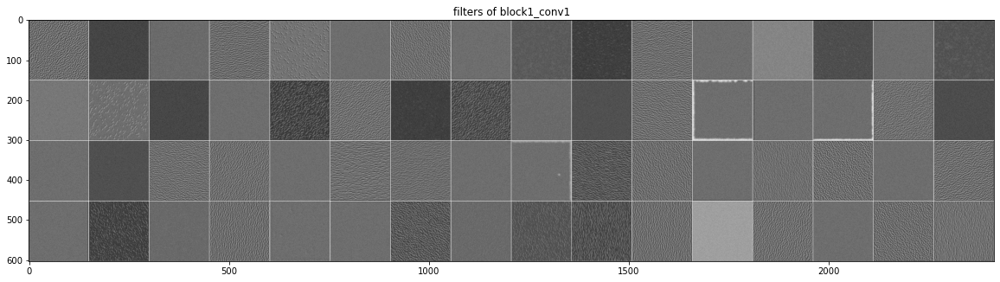

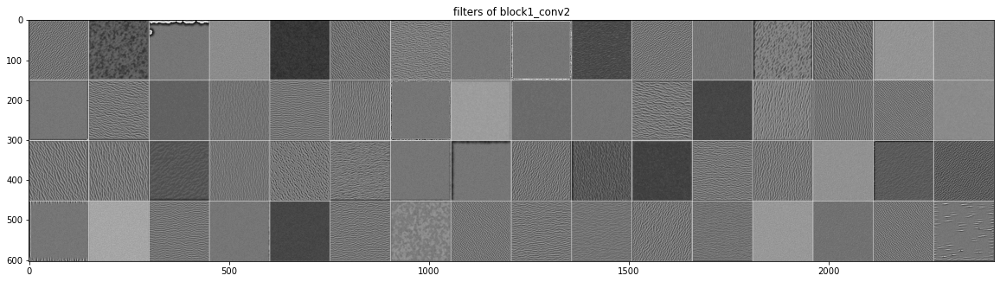

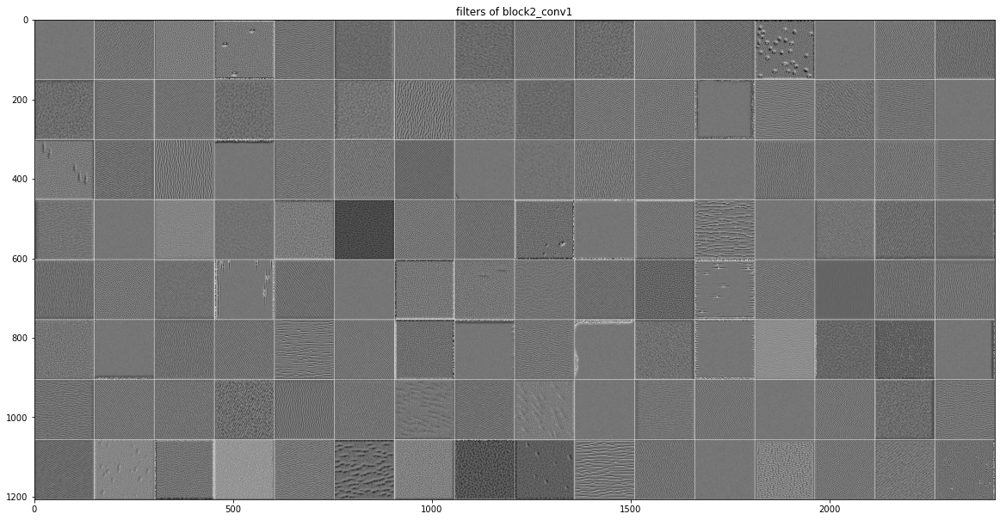

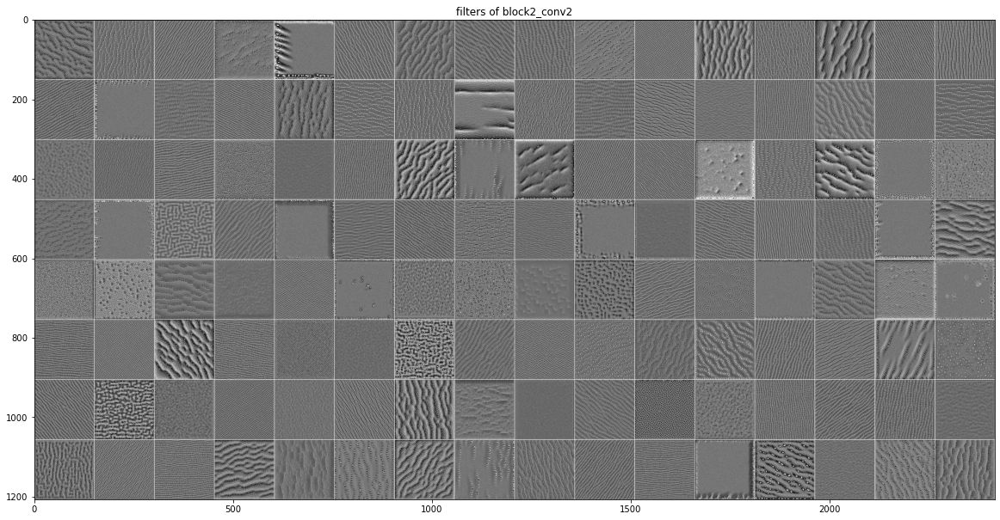

...

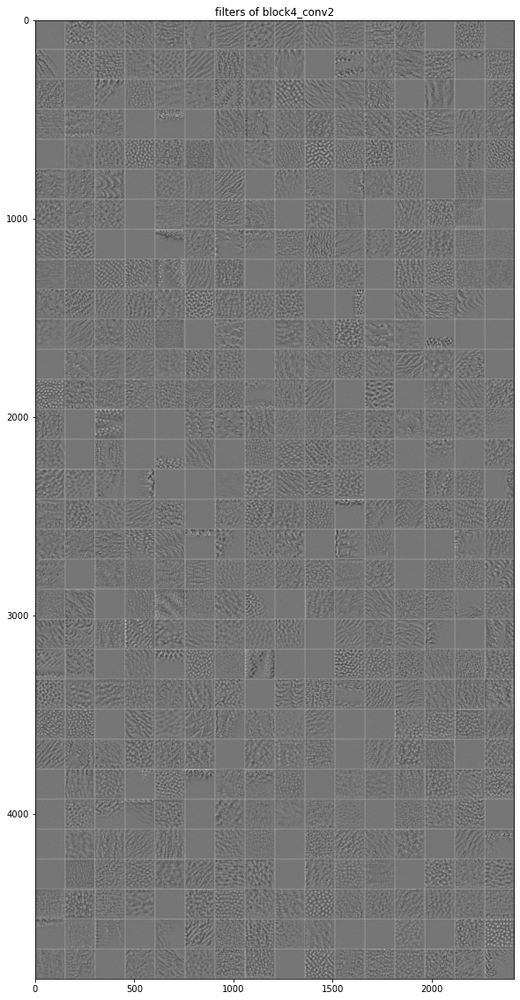

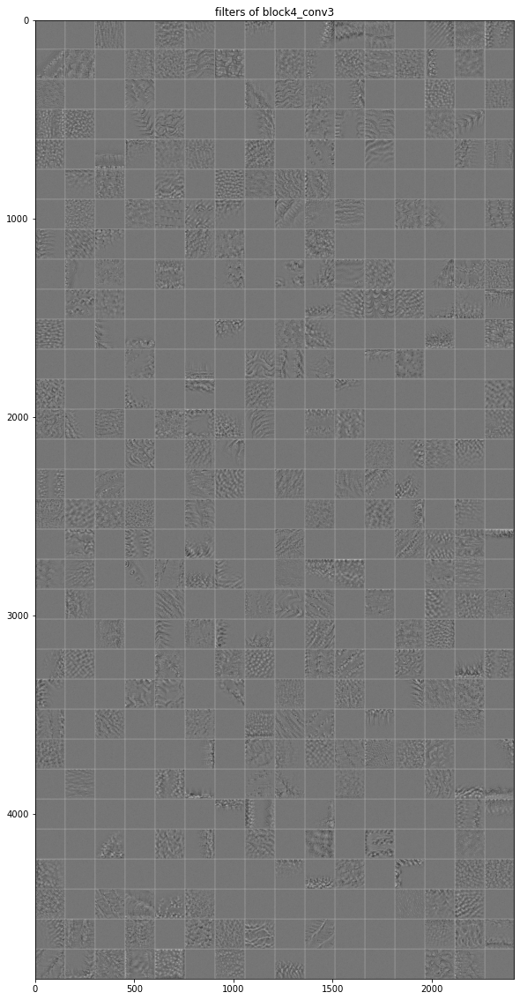

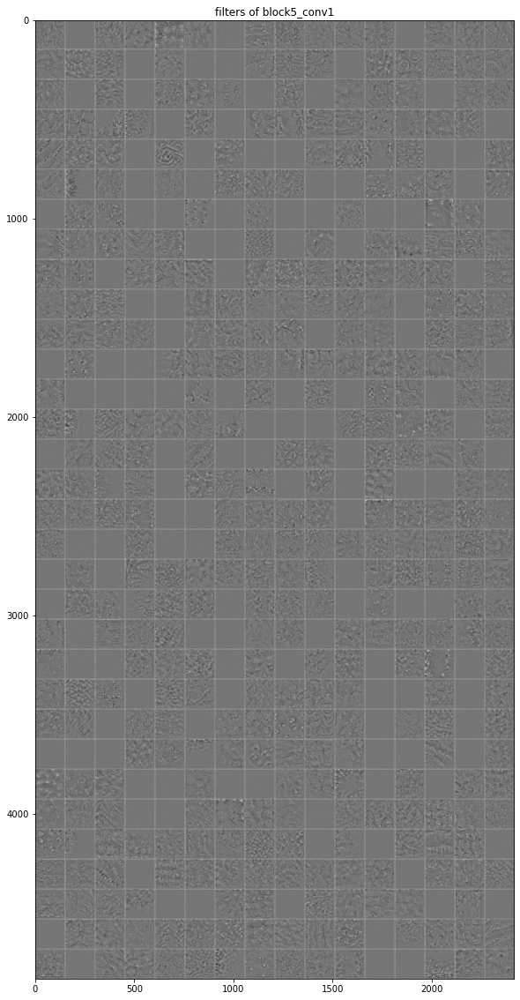

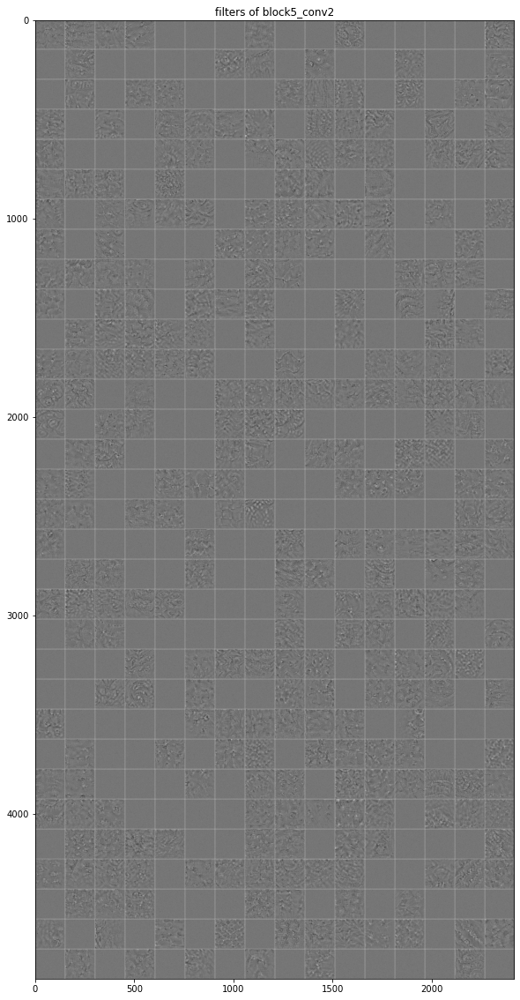

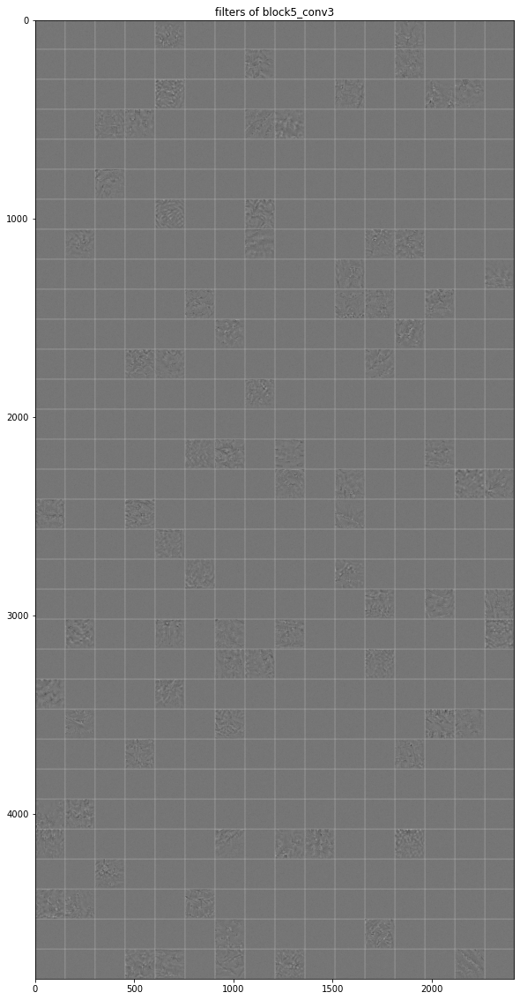

In [15]:
import keras
# Visualizing CNN Filters

size = 150
img_tensor = np.random.random((1, size, size, 3)) * 20 + 128.
print('img_tensor.shape=', img_tensor.shape)
plt.title('generate_pattern_random')
plt.imshow(img_tensor[0][:,:,0], cmap='binary')
plt.show()

# 임의의 pattern을 만들어내는 메소드
def generate_pattern(conv_name, filter_index, size=150):
    img_tensor = np.random.random((1, size, size, 3)) * 20 + 128.
    img_tensor = tf.Variable(tf.cast(img_tensor, tf.float32)) # 원래 tf.float64로 나오는데 숫자 크기를 줄이려고 tf.float32로 교체
    
    # Specify the convolution layer and the filter we want to connect to
    conv_layer = model.get_layer(conv_name)
    step_size = 1
 
    # Create a connection between the input and the target layer
    # submodel = keras.models.Model(inputs=model.input, outputs=conv_layer.output)
    submodel = keras.models.Model([model.inputs[0]], [conv_layer.output])

    # Run gradient ascent for 40 steps(40번 해서 잘됐다고 함)
    for _ in range(40):
        with tf.GradientTape() as tape:
            outputs = submodel(img_tensor)
            loss_value = tf.reduce_mean(outputs[:,:,:,filter_index]) # 여기서 loss_value는 convolutional layer output의 의미(일반적인 loss의 의미가 아님)

        grads = tape.gradient(loss_value, img_tensor)
        normalized_grads = grads / (tf.sqrt(tf.reduce_mean(tf.square(grads))) + 1e-5) # Add a small costant at the end to avoid divisions by 0
        img_tensor.assign_add(normalized_grads * step_size)
    
    # Convert values input data to the valid range for imshow with RGB data ([0..255] for integers)
    img = img_tensor[0].numpy().astype(np.uint8) 
    return img[:,:,0]
    #return img

# Visualize all filters in all layers
# 
# Now the fun part: we can start visualising every single filter in every layer. 
# For simplicity, we will only look at the first 64 filters in each layer, and will only look at the first layer 
# of each convolution block (block1_conv1, block2_conv1, block3_conv1, block4_conv1, block5_conv1). 
# We will arrange the outputs on a 8x8 grid of 64x64 filter patterns, with some black margins between each filter pattern.

conv_names = ['block1_conv1', 'block1_conv2', 'block2_conv1', 'block2_conv2', 'block3_conv1', 'block3_conv2', 'block3_conv3',
              'block4_conv1', 'block4_conv2', 'block4_conv3', 'block5_conv1', 'block5_conv2', 'block5_conv3']
for conv_name in conv_names:
    col_cnt = 16
    row_cnt = model.get_layer(conv_name).output.shape[-1]//col_cnt
    margin = 1
    
    # This a empty (black) image where we will store our results.
    results = np.zeros((row_cnt * size + (row_cnt-1) * margin, col_cnt * size + (col_cnt-1) * margin)).astype(np.uint8)
    
    for i in range(row_cnt): # iterate over the rows of our results grid
        for j in range(col_cnt): # iterate over the columns of our results grid
            # Generate the pattern for filter `i*col_cnt + j` in `conv_name`
            filter_img = generate_pattern(conv_name, i*col_cnt + j, size=size)

            # Put the result in the square `(i, j)` of the results grid
            horizontal_start = i * size + i * margin
            horizontal_end = horizontal_start + size
            vertical_start = j * size + j * margin
            vertical_end = vertical_start + size
            #results[horizontal_start:horizontal_end, vertical_start:vertical_end, :] = filter_img
            #results[horizontal_start: horizontal_end, vertical_start: vertical_end, 0] = filter_img # ksaehwa
            results[horizontal_start: horizontal_end, vertical_start: vertical_end] = filter_img # ksaehwa

    # Display the results grid
    plt.figure(figsize=(20, 20))
    plt.title('filters of '+ conv_name)
    #plt.imshow(results)
    plt.imshow(results, cmap='binary') # ksaehwa
    plt.show()

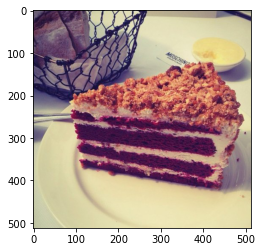

x.shape (1, 512, 512, 3)


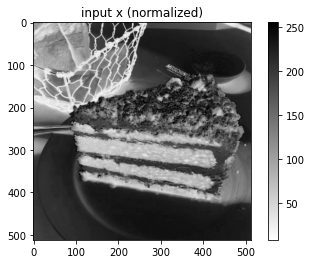

InvalidArgumentError: tensor_in_shape must have 2 spatial dimensions. 5 0 [Op:MaxPool]

In [116]:
# Visualizing CNN Activation map(Heatmap) - 어떤 Convolution 결과의 기여도가 높았는지 알아보는 방법(마지막 layer에 대해 적용)
from keras.preprocessing import image
DONUT_IDX = 2

#x = image.load_img[testImgIdx:testImgIdx+1]
img = image.load_img('C:/Users/SJH/JupyterNotebook/DeepLearning/img/Cake/467.jpg')
x = image.img_to_array(img)
#x = np.array([input_arr])
#x = x[..., np.newaxis]
x = x[np.newaxis, ...]


input_img = x / 255
plt.imshow(input_img[0])
plt.show()
#plt.imshow(img[:,:,0])
print('x.shape', x.shape) # ksaehwa
plt.title('input x (normalized)') # ksaehwa
plt.imshow(x[0][:, :, 0], cmap='binary') # ksaehwa
plt.colorbar()
plt.show() 




#print('x.shape',x.shape)
#plt.imshow();
#plt.colorbar();
#x = np.array(x)
x = x[np.newaxis, ...]
#plt.show()
import cv2

APPLE_IDX = 0
BIBIMBAP_IDX = 1
CAKE_IDX = 2
DONUT_IDX = 3
GYOZA_IDX = 4
PASTA_IDX = 5
PHO_IDX = 6
PIZZA_IDX = 7
RICE_IDX = 8
SUSHI_IDX = 9
foodIndex = [APPLE_IDX, BIBIMBAP_IDX, CAKE_IDX, DONUT_IDX, GYOZA_IDX, PASTA_IDX, PHO_IDX, PIZZA_IDX, RICE_IDX, SUSHI_IDX]



last_conv_layer = model.get_layer('block5_conv3') # Output feature map of the last conv level of VGG16
grad_model = keras.models.Model([model.inputs], [last_conv_layer.output, model.output])
# Set up GradientTape for automatic differentiation


with tf.GradientTape() as tape:
    # pass the image through the gradient model, and grab the loss associated with the specific class index
    conv_outputs, predictions = grad_model(x)
    #loss = predictions[:, foodIndex[DONUT_IDX]] # 1-loss의 의미
    loss = predictions[:, DONUT_IDX]

output = conv_outputs[0]
print('predictions.shape', predictions.shape)
print('conv_outputs.shape', conv_outputs.shape)
print('loss.shape', loss.shape)
print('predictions', predictions)
print('conv_outputs', conv_outputs)
print('loss', loss)


# Compute the gradients of the "African elephant" class with regard to the output 
# feature map of block5_conv3, given a sample image
grads = tape.gradient(loss, conv_outputs)[0]

# Vector of shape (512), where each entry is the mean intensity of the gradient over a specific feature map channel
weights = tf.reduce_mean(grads, axis=(0, 1))

# Multiplies each channel in feature-map array by "how important this channel is" with regard to the elephant class.
cam = tf.multiply(weights, output)

# The channel-wise mean of the resulting feature map is the heatmap of the class activation!
heatmap = tf.reduce_mean(cam, axis=-1).numpy()
    



In [20]:
!pip install opencv-python

[[ 1.05574667  0.68885186 -0.73921476 ... -1.26026682  0.28395916
  -0.23381163]
 [ 0.68026016 -0.14510545  0.33367157 ... -0.01230548 -0.15424332
  -1.11610776]
 [ 0.80259761 -1.42868672 -1.09304467 ... -1.20322676 -0.4188197
  -0.22311879]
 ...
 [-0.08618233 -0.79913266 -0.67525752 ... -1.5132431  -0.50550179
   0.03337676]
 [-0.20196437 -0.69204887  0.82146876 ... -1.81384033 -0.34570833
   0.36243688]
 [ 0.39160951 -2.06452004  1.00274564 ...  0.94785044  0.26460621
   0.26350559]]


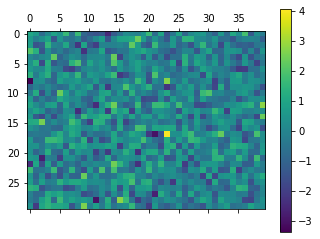

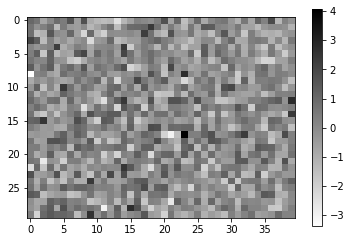

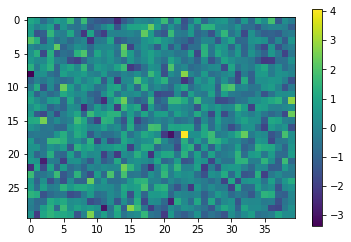

In [22]:
arr = np.random.standard_normal((30, 40))
print(arr)
plt.matshow(arr)
plt.colorbar()
plt.show()

plt.imshow(arr, cmap='binary')
plt.colorbar()
plt.show()
plt.imshow(arr)
plt.colorbar()
plt.show()

In [97]:
# #### Visualize the heatmap

# Postprocessing heatmap
heatmap = (heatmap - np.min(heatmap)) / (heatmap.max() - heatmap.min())
print('heatmap after preprocessing', heatmap)

plt.matshow(heatmap)
plt.colorbar()
plt.show()

plt.imshow(heatmap, cmap='binary')
plt.colorbar()
plt.show()

# #### Generate superimposed original image over the heatmap
# Use cv2 to load the original image
#cv_img = cv2.imread(IMG_PATH)
#cv_img = x[0][:, :, 0] # ksaehwa, trouser
#cv_img = X_test_org[0] # ksaehwa, 0 ankle boot, 2 trouser
cv_img = X_test_org[testImgIdx] # ksaehwa, 0 ankle boot, 2 trouser

print('cv_img', cv_img)

# Resize the heatmap to be the same as the original image
heatmap = cv2.resize(heatmap, (cv_img.shape[1], cv_img.shape[0]))

# Converts heatmap to RGB
heatmap = (heatmap * 255).astype(np.uint8)
plt.imshow(heatmap) #, cmap='gray'
plt.colorbar()
plt.show()


#cv_img = ((255-cv_img)).astype(np.uint8) # ksaehwa
cv_img = (cv_img).astype(np.uint8) # ksaehwa
print('cv_img after unit8', cv_img)
plt.imshow(cv_img) #, cmap='gray'
plt.colorbar()
plt.show()
#cv_img = (cv_img *X_std[0] + X_mean[0]).astype(np.uint8) # ksaehwa
#plt.imshow(cv_img) #, cmap='gray'
#plt.show()

#cv_img = cv2.imread('trouser.png', 0) # ksaehwa
cv_img = cv2.applyColorMap(cv_img, cv2.COLORMAP_BONE) # ksaehwa
#cv_img = cv2.applyColorMap(cv_img, cv2.COLORMAP_HOT) # ksaehwa
print('cv_img.shape', cv_img.shape)
print('cv_img after BONE', cv_img)
plt.imshow(cv_img) #, cmap='gray'
plt.colorbar()
plt.show()

# Apply a color map to the heatmap
#heatmap = cv2.applyColorMap(heatmap, cv2.COLORMAP_JET)
#heatmap = cv2.applyColorMap(heatmap, cv2.COLORMAP_HOT) # ksaehwa
heatmap = cv2.applyColorMap(heatmap, cv2.COLORMAP_BONE) # ksaehwa
plt.imshow(heatmap) #, cmap='gray'
plt.colorbar()
plt.show()

# Applies the heatmap to the original image. The variable alpha is a heatmap intensity factor
alpha = 0.4 # org
#alpha = 0.8 # ksaehwa
output_image = cv2.addWeighted(cv_img, alpha, heatmap, 1 - alpha, 0)
print(output_image)
plt.imshow(output_image) #, cmap='gray'
plt.colorbar()
plt.show()

#cv2.imwrite('./resources/elephant_cam.jpg', output_image)
# <img src="./resources/elephant_cam.jpg">
# 
# It is interesting to note that the ears of the elephant cub are strongly activated: 
# this is probably how the network can tell the difference between African and Indian elephants.

NameError: name 'heatmap' is not defined